# **Aprendizaje Automático para Machine Learning**

## Actividad individual 4: "TRANSFERENCIA DE ESTILO"

Fabio Santamaría Iglesias

21/07/2021

# Neural Style Transfer
En el pdf de la actividad se describe brevemente el método de generación de imágenes **Neural Style Transfer**. No se pretende adquirir un conocimiento profundo de este método sino utilizar la práctica para adquirir un **conocimiento intuitivo de las Redes Neuronales Convolucionales como extractores de características**.

En primer lugar, importamos PyTorch junto con otros paquetes.

In [ ]:
from PIL import Image
from io import BytesIO
import matplotlib.pyplot as plt
import numpy as np

import torch
import torch.optim as optim
import requests
from torchvision import transforms, models

## Transfer Learning: descargamos VGG19 
En esta actividad vamos a utilizar el primer bloque de VGG19, que sirve para **extraer las características** de la imagen de entrada

In [ ]:
# reutilizamos el modelo pre-entrenado VGG19
vgg_all = models.vgg19(pretrained=True)

# pero seleccionamos solo el primer bloque de la red que extrae features
vgg_features = vgg_all.features

# congelamos porque solo queremos optimizar la imagen target
for param in vgg_features.parameters():
    param.requires_grad_(False)

## VGG19 - Clasificador
Aunque en esta práctica solo vamos a utilizar el bloque extractor de características, podemos aprovechar para echarle un vistazo al bloque de **clasificación**.

Comprobamos que el segundo bloque, el clasificador, está compuesto por:
* capas lineales (Linear)
* funciones de activación ReLU
* capas de dropout para evitar overfitting

Si quisiéramos utilizar VGG19 como clasificador de un dataset de imágenes, deberíamos sustituir este bloque por otro similar con tantas salidas como clases haya en el dataset. 

In [ ]:
vgg_classifier = vgg_all.classifier
print(vgg_classifier)

Sequential(
  (0): Linear(in_features=25088, out_features=4096, bias=True)
  (1): ReLU(inplace=True)
  (2): Dropout(p=0.5, inplace=False)
  (3): Linear(in_features=4096, out_features=4096, bias=True)
  (4): ReLU(inplace=True)
  (5): Dropout(p=0.5, inplace=False)
  (6): Linear(in_features=4096, out_features=1000, bias=True)
)


## Pasamos modelo a GPU si está disponible

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

vgg_features.to(device)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

## load_image
Función para cargar una imagen

In [ ]:
def load_image(img_path, max_size=300, shape=None):
    ''' Load in and transform an image, making sure the image
       is <= max_size pixels in the x-y dims.'''
    if "http" in img_path:
        response = requests.get(img_path)
        image = Image.open(BytesIO(response.content)).convert('RGB')
    else:
        image = Image.open(img_path).convert('RGB')
    
    # large images will slow down processing
    if max(image.size) > max_size:
        size = max_size
    else:
        size = max(image.size)
    
    if shape is not None:
        size = shape

    # VGG está normalizada con los valores de Imagenet: 0.406, 0.456, 0.485 en BGR, que invertimos en RGB.
    # En rango 0-255 seria 103.94, 116.78, 123.68 en BGR
    in_transform = transforms.Compose([
                        transforms.Resize(size),
                        transforms.ToTensor(),
                        transforms.Normalize((0.485, 0.456, 0.406), 
                                             (0.229, 0.224, 0.225))])

    # con :3 eliminamos el último canal de la primera dimensión, que es el alfa e indica la transparencia
    # con unsqueeze(0) añadimos como primera dimensión el batch
    image = in_transform(image)[:3,:,:].unsqueeze(0)
    
    return image

## Carga de las imágenes de contenido y estilo
Además, cambiamos tamaño de la imagen de estilo a la de contenido.

In [ ]:
# cargamos las imágenes de contenido y estilo
img_quinta = "https://github.com/albertojulian/master-ub/raw/main/quinta.jpeg"
img_palamos = "https://github.com/albertojulian/master-ub/raw/main/playa_palamos.jpg"
img_soto = "https://github.com/albertojulian/master-ub/raw/main/soto_cruz_mazo.jpg"

content = load_image(img_soto).to(device)

img_van_gogh = "https://upload.wikimedia.org/wikipedia/commons/thumb/e/ea/Van_Gogh_-_Starry_Night_-_Google_Art_Project.jpg/1024px-Van_Gogh_-_Starry_Night_-_Google_Art_Project.jpg"
img_kandinsky = "https://upload.wikimedia.org/wikipedia/commons/b/b4/Vassily_Kandinsky%2C_1913_-_Composition_7.jpg"

# cambia tamaño de la imagen de estilo: coge los dos últimos valores de shape de la imagen de contenido
style = load_image(img_kandinsky, shape=content.shape[-2:]).to(device)

## im_convert 
Es una función de ayuda para pasar una imagen de Tensor a numpy y poderla visualizar

In [ ]:
def im_convert(tensor):
    
    image = tensor.to("cpu").clone().detach()
    image = image.numpy().squeeze()
    image = image.transpose(1,2,0) # cambia ancho por alto
    image = image * np.array((0.229, 0.224, 0.225)) + np.array((0.485, 0.456, 0.406))
    image = image.clip(0, 1)

    return image

## Veamos las imágenes de contenido y estilo

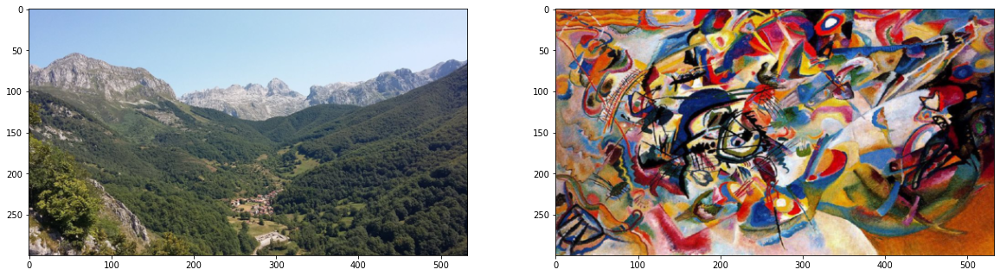

In [ ]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
ax1.imshow(im_convert(content))
ax2.imshow(im_convert(style))

## Capas de vgg_features
Veamos los identificadores de capas del extractor de características, vgg_features

In [ ]:
print(vgg_features)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

## Extracción de características
La función get_features se utiliza para extraer las características de las imágenes de contenido y estilo.

En primer lugar, filtramos las capas que vamos a tener en cuenta para la extracción de características según se indica en el artículo de referencia. Utilizaremos varias capas para el estilo pero solo una (conv4_2) para el contenido.

A continuación, extraemos las características de la imagen para las capas seleccionadas.

In [ ]:
def get_features(image, model, layers=None):
    
    if layers is None:
        layers = {'0': 'conv1_1',
                  '5': 'conv2_1', 
                  '10': 'conv3_1', 
                  '19': 'conv4_1',
                  '21': 'conv4_2',  ## contenido
                  '28': 'conv5_1'}

    features = {}
    x = image
    # model._modules es un diccionario con todas las capas
    for name, layer in model._modules.items():
        x = layer(x) # la imagen se va transformando en cada capa...
        if name in layers: # ...pero solo extraemos las características de las capas seleccionadas
            features[layers[name]] = x
            
    return features


## Matriz Gram
El método Style Transfer utiliza la matriz Gram o Gramian para procesar las características.

Ver https://en.wikipedia.org/wiki/Gramian_matrix 

In [ ]:
def gram_matrix(tensor):

    # obtenemos batch_size, depth, height y width del Tensor
    b, d, h, w = tensor.size()

    # convertimos el tensor a 2D multiplicando dimensiones entre sí 
    tensor = tensor.view(b * d, h * w)
    
    # calculamos la matriz gram multiplicando el tensor por su transpuesto
    gram = torch.mm(tensor, tensor.t())
    
    return gram

## Definimos los parámetros a probar
* Definimos los pesos de las capas de estilo. Excluimos conv4_2 porque es la capa de la que extraemos el contenido.
* Definimos valores de los pesos de contenido y estilo para la función de pérdida (content_weight, style_weight).
* Definimos la tasa de aprendizaje.
* Definimos el número de iteraciones (steps)


In [ ]:
style_weights = {'conv1_1': 1.,
                 'conv2_1': 0.75,
                 'conv3_1': 0.2,
                 'conv4_1': 0.2,
                 'conv5_1': 0.2}

content_weight = 1  # alpha
style_weight = 1e6  # beta

learning_rate = 0.1

steps = 500 # número de iteraciones

# definimos cada cuántas imágenes queremos hacer una visualización intermedia
show_every = 100

## Inicialización y entrenamiento del modelo
Tareas:
* definimos las capas del nuevo modelo
* inicializamos la imagen generada con la imagen de contenido
* definimos el optimizador
* modificamos la imagen generada mediante la función de pérdida, compuesta por la suma de la pérdida de estilo y la de contenido ponderadas

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


Pérdida total:  3651034.5
Step 100


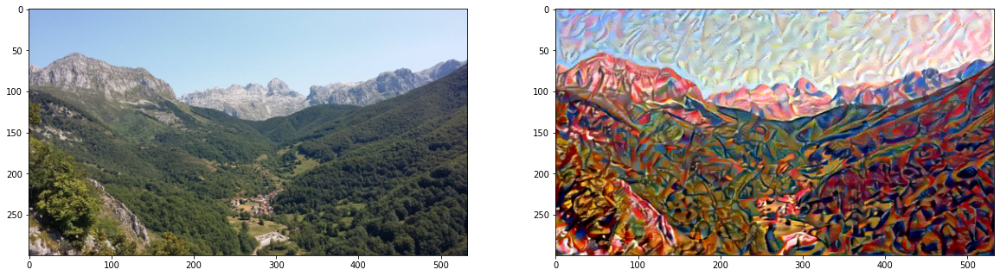

Pérdida total:  1509287.375
Step 200


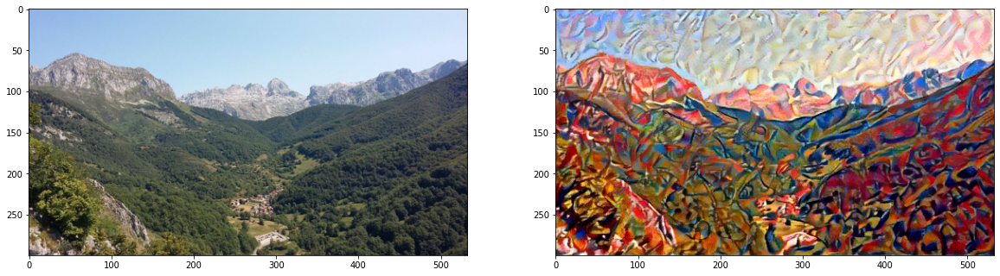

Pérdida total:  893350.4375
Step 300


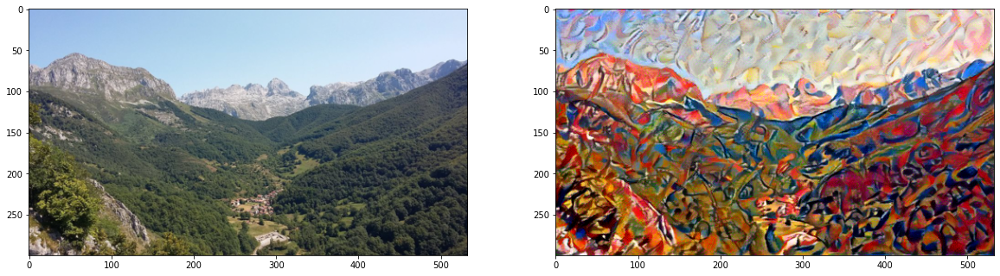

Pérdida total:  656912.6875
Step 400


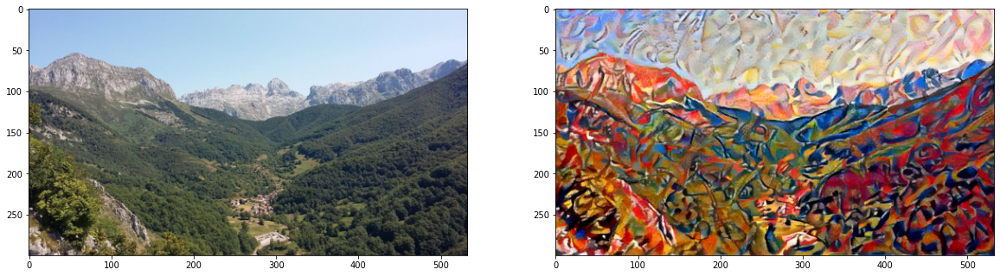

Pérdida total:  554413.1875
Step 500


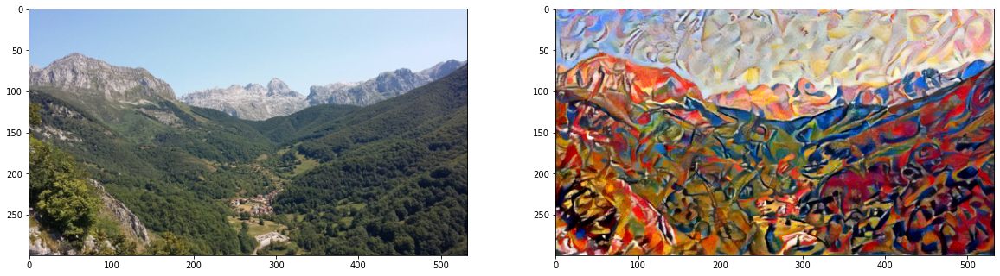

In [ ]:
# extraemos características de contenido y estilo de las imágenes originales
content_features = get_features(content, vgg_features)
style_features = get_features(style, vgg_features)

# calculamos la matriz gram de cada capa de estilo
style_grams = {layer: gram_matrix(style_features[layer]) for layer in style_features}

# creamos una tercera imagen "target" que se va a ir modificando
# La inicializamos con la imagen de contenido...
# ...y le vamos cambiando el estilo
target = content.clone().requires_grad_(True).to(device)

# definimos el optimizador sobre los parámetros de la imagen target
optimizer = optim.Adam([target], lr=learning_rate)

for ii in range(1, steps+1):
    
    # extraemos las características de la imagen generada
    target_features = get_features(target, vgg_features)
    
    # definimos la función de pérdida de contenido
    content_loss = torch.mean((target_features['conv4_2'] - content_features['conv4_2'])**2)
    
    # definimos la función de pérdida de estilo como suma de la pérdida de cada capa
    style_loss = 0
    for layer in style_weights:
        target_feature = target_features[layer]
        target_gram = gram_matrix(target_feature)
        _, d, h, w = target_feature.shape
        style_gram = style_grams[layer]
        # calculamos la "pérdida de estilo" de la capa actual y la ponderamos 
        layer_style_loss = style_weights[layer] * torch.mean((target_gram - style_gram)**2)
        # la añadimos a la pérdida de estilo
        style_loss += layer_style_loss / (d * h * w)
        
    # calculamos la pérdida total
    total_loss = content_weight * content_loss + style_weight * style_loss
    
    # actualizamos la imagen generada mediante el optimizador
    optimizer.zero_grad()
    total_loss.backward()
    optimizer.step()
    
    # mostramos las imágenes intermedias y su pérdida
    if  ii % show_every == 0:
        print('Pérdida total: ', total_loss.item())
        print('Step', ii)
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
        ax1.imshow(im_convert(content))
        ax2.imshow(im_convert(target))
        plt.show()

## Veamos la imagen de contenido y la generada (final)

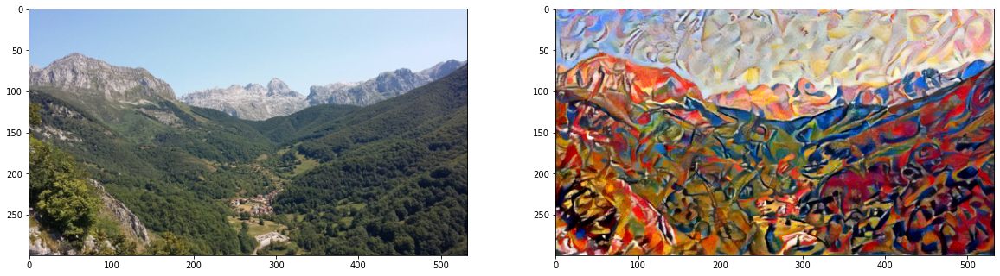

In [ ]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
ax1.imshow(im_convert(content))
ax2.imshow(im_convert(target))

## Almacenamiento en local
Por último, si queremos conservar la imagen resultante, podemos bajarla imagen a nuestro ordenador.

In [ ]:
from google.colab import files
target_path = "content_style.jpg"

target_im = im_convert(target)
target_im = target_im * 255
target_im = target_im.astype('uint8')
Image.fromarray(target_im).save(target_path) 

files.download(target_path)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# Preguntas
### 1 - ¿Cuántas capas lineales contiene el clasificador de VGG19

In [ ]:
print(vgg_classifier)

Sequential(
  (0): Linear(in_features=25088, out_features=4096, bias=True)
  (1): ReLU(inplace=True)
  (2): Dropout(p=0.5, inplace=False)
  (3): Linear(in_features=4096, out_features=4096, bias=True)
  (4): ReLU(inplace=True)
  (5): Dropout(p=0.5, inplace=False)
  (6): Linear(in_features=4096, out_features=1000, bias=True)
)


En el framework de pytorch se define la transformación lineal que ocurre entre una capa y la siguiente mediante la función Linear. Como vemos, el clasificador original de VGG19 tiene 3 funciones de este tipo y, por tanto, 3 capas convolucionales totalmente conectadas fully connected más una capa de entrada o input. A veces, como en este caso, no se tiene en consideración la capa de entrada a la hora de contar las capas.

De esta manera, la primera capa oculta toma 25088 características y aplica sobre ella una matriz de pesos que reduce las componentes a 4096. Dado que la condición de bias está a true, la transformación consiste en una matriz de 25088 + 1 filas y 4096 columnas. Las siguientes capas se comportan de forma análoga. De esta forma, se va reduciendo el número de características hasta el número final de etiquetas a clasificar.

Hay que destacar que las imágenes de partida tienen una resolución de 224x224 (3 canales), es decir, más de 150.000 componentes independientes. Sin embargo, como hemos visto, el clasificador toma de entrada tan sólo 25088 características. Esto es debido al primer bloque del modelo, compuesto por capas convolucionales y capas de max pooling. Las primeras aumentan el número de características creando de un input varios a través de la aplicación de filtros, mientras que las segundas van reduciendo la dimensionalidad. Así, vemos cómo el primer bloque acaba disminuyendo el número de componentes de más de 150.000 a tan solo 25088.

La función de activación para las neuronas de la primera capa oculta se especifica con la primera función ReLU. De la misma forma, las neuronas de la segunda capa oculta también se activarán según la segunda función ReLU. La capa de entrada no necesita una función de activación, ya que los valores de esta capa son el input de la red. Tampoco la capa de salida, ya que estos valores son el output de la red. Dependiendo de cómo queramos calcular las probabilidades que asigna al modelo a pertenecer a una clase u otra colocaremos sobre esta última capa una función u otra.

Por su lado, la función dropout pone a 0 algunos valores siguiendo para ello una distribución de probabilidad de Bernoulli. Con p = 0.5 estamos indicando que cada valor que atraviese esta función se pondrá a 0 con una probabilidad del 50%. En nuestro caso, la primera función dropout está entre la primera capa oculta y la segunda. Por tanto, alrededor de la mitad de valores calculados por la primera capa oculta se pondrán a 0 antes de hacer la transformación lineal que nos lleve a la segunda capa. La segunda función dropout se encuentra situada entre la segunda y la última capa, por lo que de igual manera la mitad de valores obtenidos en la segunda capa tenderán a ponerse a 0. Se ha demostrado que hacer esto reduce el overfitting de la red.


### 2 - ¿Cuántas clases distintas puede reconocer VGG19 en su configuración original?

La salida de la última capa del modelo contiene 1000 neuronas, por tanto, puede reconocer hasta 1000 clases diferentes.

### 3 - Indica los identificadores de capas convolucionales a continuación de capas de max pooling

In [ ]:
print(vgg_features)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

Las capas convolucionales que se encuentran a continuación de una capa de *max pooling* se pueden identificar con los números 5, 10, 19 y 28. Precisamente estas, junto con la capa 0, son las que hemos usado como capas de estilo (ver método get_features). En todas ellas se especifican los parámetros más importantes de entrada:

*	in_channels (int): Número de canales de la imagen de entrada. Si la entrada es una imagen a color, este número sería típicamente 3 (4 en algunas imágenes de satélites). Con imágenes en blanco y negro, 1. Si la entrada es una capa predecesora, este número ha de ser igual al número de canales de salida de la capa predecesora. En nuestro caso, las capas de convolución indicadas son precedidas por capas de max pooling por lo que el número de entradas es igual al número de canales de salida de esta capa.
*	out_channels (int) – Número de canales producidos por la convolución. Comúnmente se le conoce como el número de filtros a aplicar o número de features.
*	kernel_size (int or tuple) – Tamaño de la matriz de convolución, también llamada kernel. Se suele introducir el parámetro en forma de tupla, con el primer elemento indicando el número de filas y el segundo el número de columnas. Cuando la matriz es cuadrada y el resto de argumentos (como el stride) se aplican por igual tanto a filas como columnas, entonces se pueden indicar las dimensiones de la matriz pasando un sólo número.
^*	stride (int or tuple, opcional con valor por defecto 1) – Número de píxeles que se avanzan al ir aplicando las matrices de convolución. Si se introduce una tupla, este avance puede ser diferente según sea horizontal o vertical.
*	padding (int, tuple or str, opcional con valor por defecto 0) – Añade valores de relleno en todas las cuatro fronteras de cada canal. Puede tomar los valores {‘valid’, ‘same’}, un número o una tupla (padH horizontal, padW vertical) que indican el número de píxeles a rellenar con 0. Tener padding='valid' es lo mismo que no tener ningún relleno. Con padding='same' se rellenan los bordes del input de forma que el output tenga la misma forma dimensional que el input. Sin embargo, esta forma no soporta añadir más de 1 píxel por borde.

Así, a modo de ejemplo fijémonos en la capa 5. Tiene in_channels = 64 porque su capa predecesora da como resultado 64 canales diferentes. Asimismo, la salida se define con out_channels = 128, duplicando el número de canales de entrada. Además, cuenta con kernel_size = (3,3) lo que nos indica que se aplican matrices de convolución 3x3. El Stride = 1 significa que la convolución se aplicará a todos los píxeles de los canales de entrada, ya que se avanzará contiguamente de píxel a píxel a la hora de aplicar los filtros. Por último, padding = (1,1) nos indica que se están añadiendo valores 0 a los cuatro lados de cada input. Como estamos usando un kernel de tamaño 3x3, con sólo una fila o columna fuera del elemento central, la dimensión de las imágenes de entrada y salida serán las mismas.


### 4 - ¿Qué influencia tienen los cambios solicitados (content_weight, style_weight, learning rate, steps) en las imágenes intermedias y en la imagen resultante?

Se piden comprobar los siguientes casos:

* Content_weight (peso del error en la capa de contenido) y style_weight (peso del error en las capas de estilo): probar con [1 y 1e6], [1e2 y 1e2], [1e2 y 1e-2]. 
* Learning rate (tasa de aprendizaje del optimizador): probar con 0.003, 0.01, 0.1. 
* Steps (etapas de entrenamiento): probar con 500, 1000, 2000.

El primer paso para realizar esta comprobación es definir una función *train* con el código visto previamente:

In [ ]:
def train(content, style, vgg_features, device, learning_rate, steps, style_weights, style_weight, content_weight, show_every):

    # extraemos características de contenido y estilo de las imágenes originales
    content_features = get_features(content, vgg_features)
    style_features = get_features(style, vgg_features)

    # calculamos la matriz gram de cada capa de estilo
    style_grams = {layer: gram_matrix(style_features[layer]) for layer in style_features}

    # creamos una tercera imagen "target" que se va a ir modificando
    # La inicializamos con la imagen de contenido...
    # ...y le vamos cambiando el estilo
    target = content.clone().requires_grad_(True).to(device)

    # definimos el optimizador sobre los parámetros de la imagen target
    optimizer = optim.Adam([target], lr=learning_rate)

    for ii in range(1, steps+1):
        
        # extraemos las características de la imagen generada
        target_features = get_features(target, vgg_features)
        
        # definimos la función de pérdida de contenido
        content_loss = torch.mean((target_features['conv4_2'] - content_features['conv4_2'])**2)
        
        # definimos la función de pérdida de estilo como suma de la pérdida de cada capa
        style_loss = 0
        for layer in style_weights:
            target_feature = target_features[layer]
            target_gram = gram_matrix(target_feature)
            _, d, h, w = target_feature.shape
            style_gram = style_grams[layer]
            # calculamos la "pérdida de estilo" de la capa actual y la ponderamos 
            layer_style_loss = style_weights[layer] * torch.mean((target_gram - style_gram)**2)
            # la añadimos a la pérdida de estilo
            style_loss += layer_style_loss / (d * h * w)
            
        # calculamos la pérdida total
        total_loss = content_weight * content_loss + style_weight * style_loss
        
        # actualizamos la imagen generada mediante el optimizador
        optimizer.zero_grad()
        total_loss.backward()
        optimizer.step()
        
        # mostramos las imágenes intermedias y su pérdida
        if  ii % show_every == 0:
            print('Pérdida total: ', total_loss.item())
            print('Pérdida contenido: ', content_loss.item())
            print('Pérdida estilo: ', style_loss.item())
            print('Step', ii)
            fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
            ax1.imshow(im_convert(content))
            ax2.imshow(im_convert(target))
            plt.show()

    return target 

De esta forma, podemos crear bucles con los diferentes parámetros a probar y obtener los resultados de una forma más limpia: 

Learning Rate 0.003
Content weight: 1 - Style weight: 1000000.0
Pérdida total:  29464542.0
Pérdida contenido:  11.765971183776855
Pérdida estilo:  29.464529037475586
Step 500


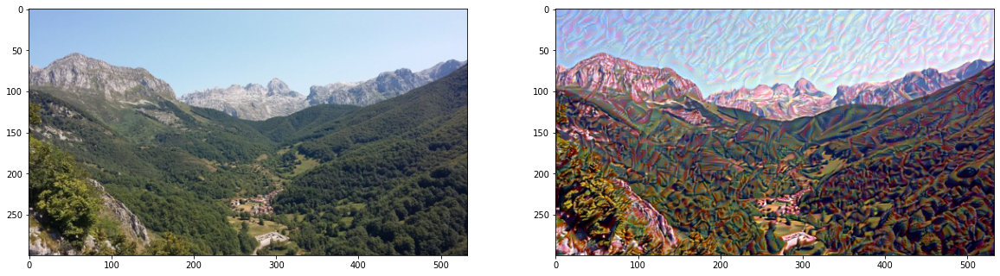

Pérdida total:  11345573.0
Pérdida contenido:  12.941364288330078
Pérdida estilo:  11.345560073852539
Step 1000


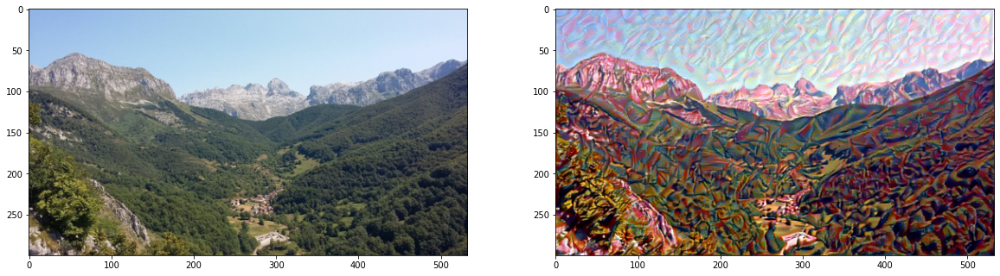

Pérdida total:  6439086.0
Pérdida contenido:  13.39420223236084
Pérdida estilo:  6.439072608947754
Step 1500


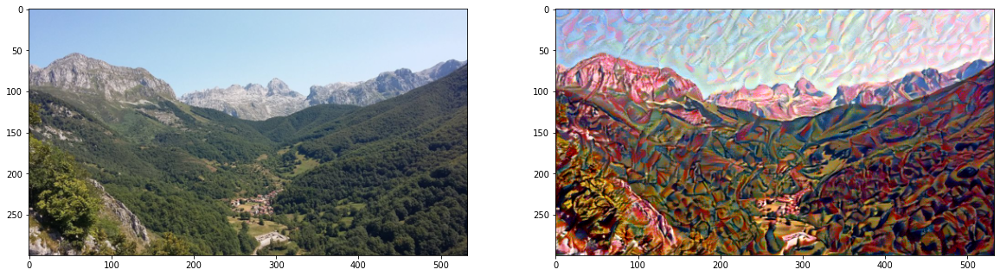

Pérdida total:  4067162.5
Pérdida contenido:  13.65134048461914
Pérdida estilo:  4.067148685455322
Step 2000


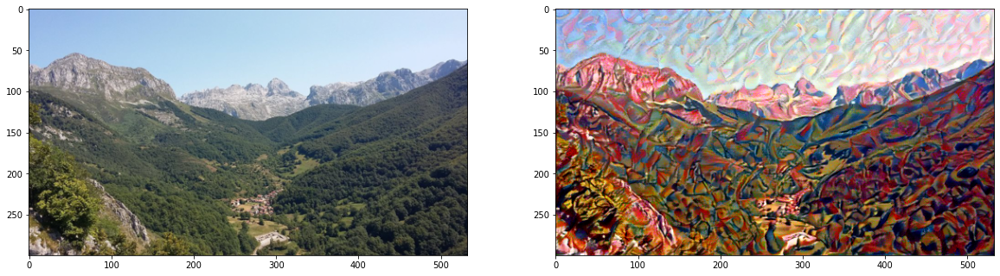

################################################################
Content weight: 100.0 - Style weight: 100.0
Pérdida total:  3760.940185546875
Pérdida contenido:  6.907507419586182
Pérdida estilo:  30.701894760131836
Step 500


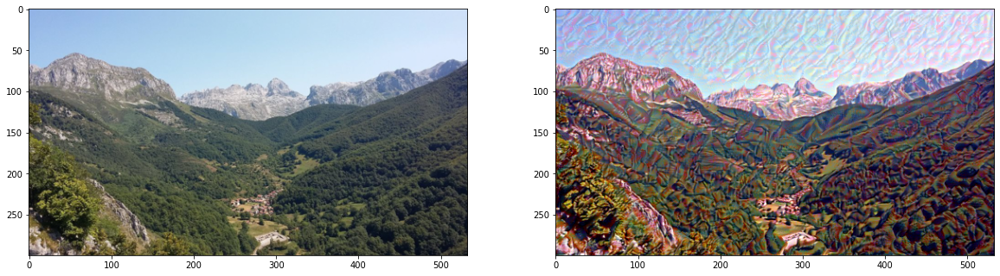

Pérdida total:  1870.33203125
Pérdida contenido:  5.9375762939453125
Pérdida estilo:  12.765743255615234
Step 1000


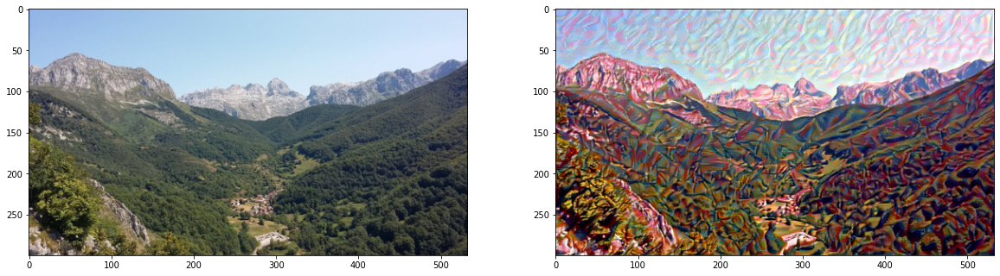

Pérdida total:  1319.931396484375
Pérdida contenido:  5.3267316818237305
Pérdida estilo:  7.872581958770752
Step 1500


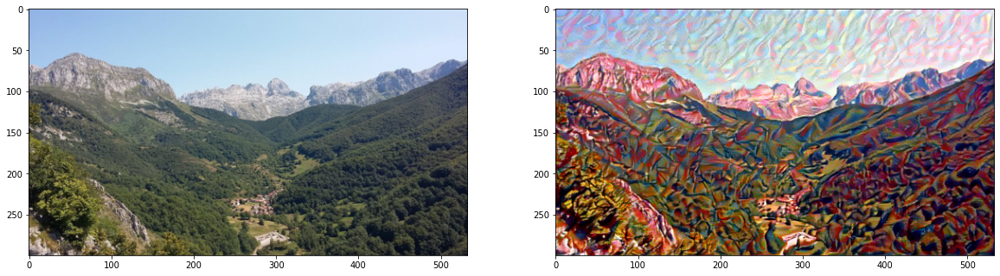

Pérdida total:  1044.2275390625
Pérdida contenido:  4.924305438995361
Pérdida estilo:  5.517970085144043
Step 2000


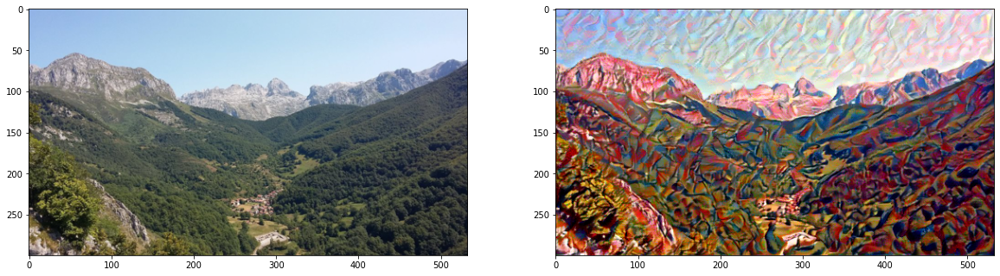

################################################################
Content weight: 100.0 - Style weight: 0.01
Pérdida total:  5.121780872344971
Pérdida contenido:  0.0037858178839087486
Pérdida estilo:  474.3199157714844
Step 500


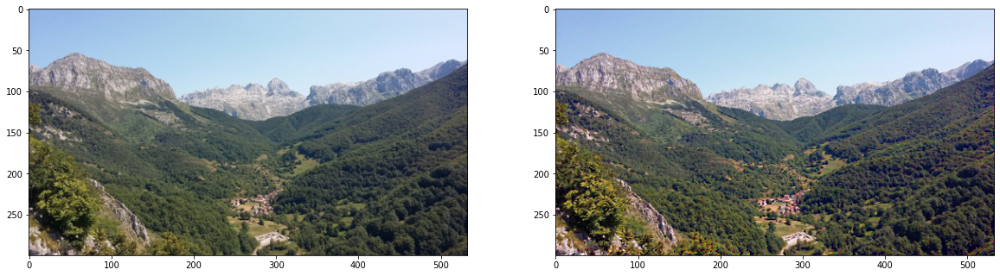

Pérdida total:  3.630699396133423
Pérdida contenido:  0.004687638953328133
Pérdida estilo:  316.1935729980469
Step 1000


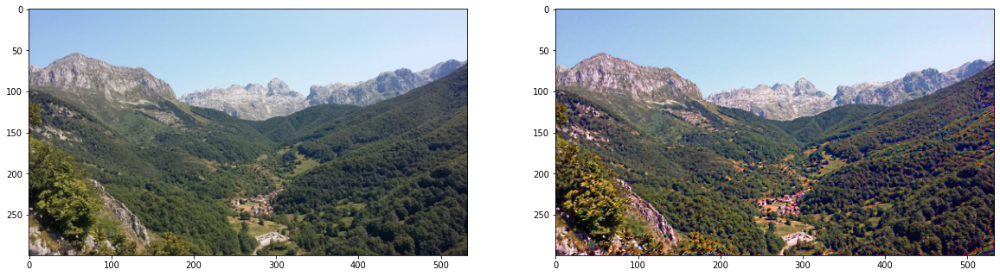

Pérdida total:  3.008327007293701
Pérdida contenido:  0.004655627068132162
Pérdida estilo:  254.27645874023438
Step 1500


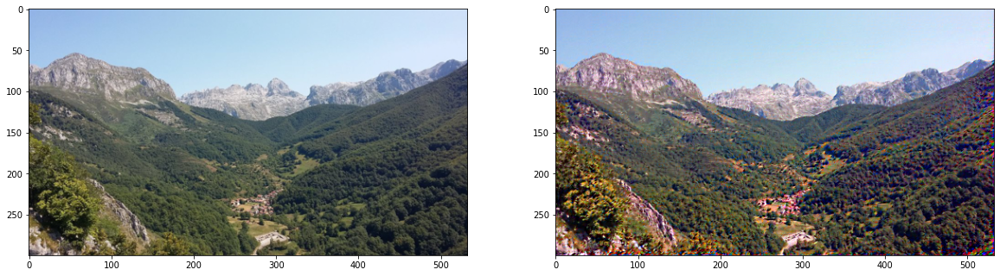

Pérdida total:  2.841277599334717
Pérdida contenido:  0.00596214085817337
Pérdida estilo:  224.50634765625
Step 2000


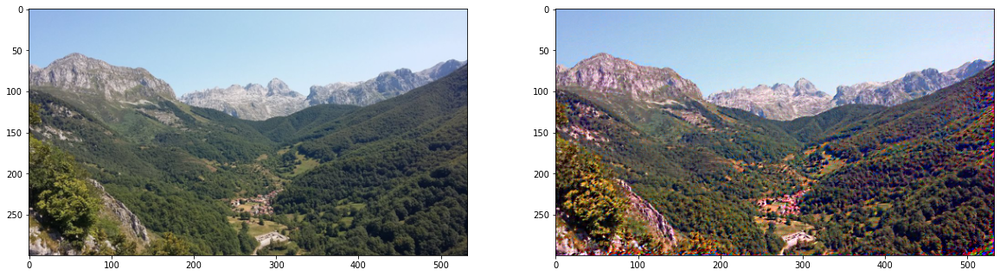

################################################################
################################################################
Learning Rate 0.01
Content weight: 1 - Style weight: 1000000.0
Pérdida total:  6808073.0
Pérdida contenido:  13.316864967346191
Pérdida estilo:  6.8080596923828125
Step 500


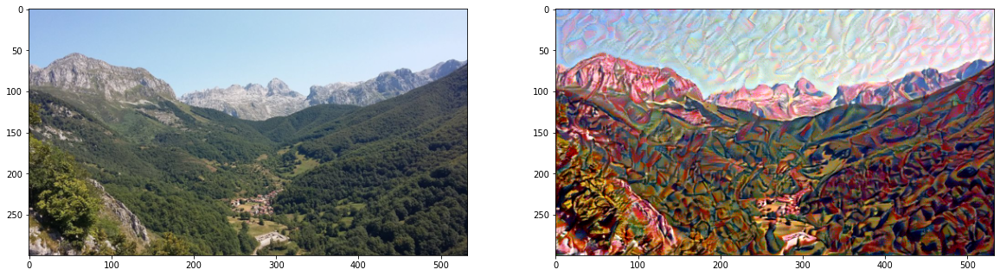

Pérdida total:  2517994.0
Pérdida contenido:  13.8113374710083
Pérdida estilo:  2.5179803371429443
Step 1000


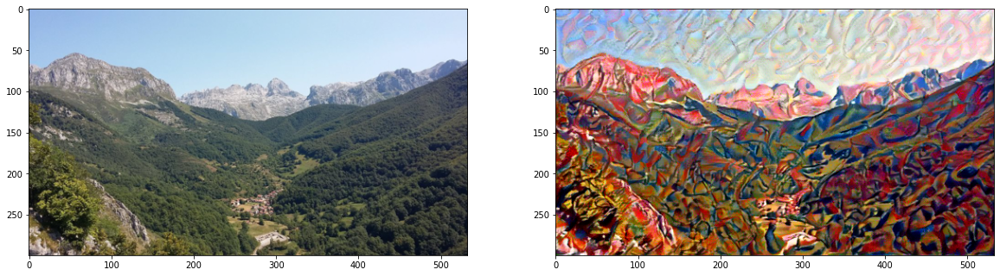

Pérdida total:  1322236.125
Pérdida contenido:  14.122960090637207
Pérdida estilo:  1.3222219944000244
Step 1500


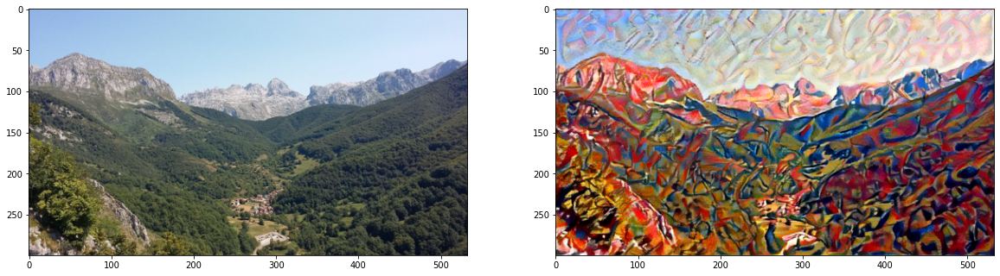

Pérdida total:  835984.5625
Pérdida contenido:  14.312771797180176
Pérdida estilo:  0.8359702229499817
Step 2000


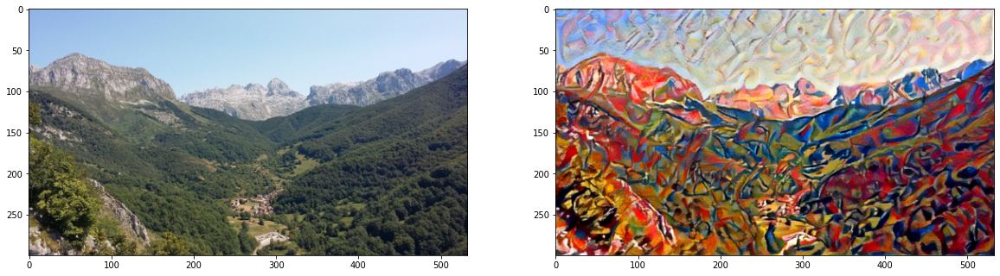

################################################################
Content weight: 100.0 - Style weight: 100.0
Pérdida total:  1367.180419921875
Pérdida contenido:  5.436738014221191
Pérdida estilo:  8.235066413879395
Step 500


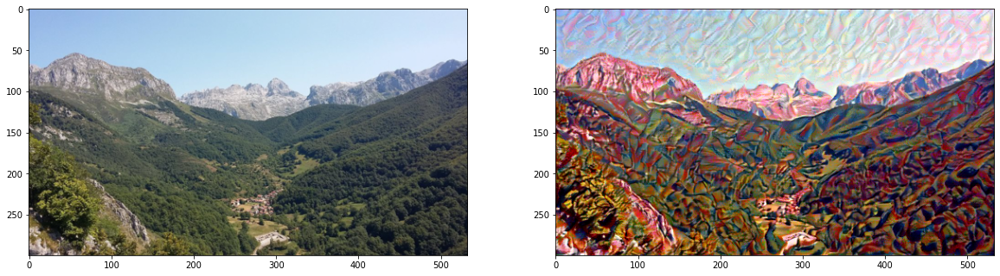

Pérdida total:  855.9051513671875
Pérdida contenido:  4.589914321899414
Pérdida estilo:  3.969136953353882
Step 1000


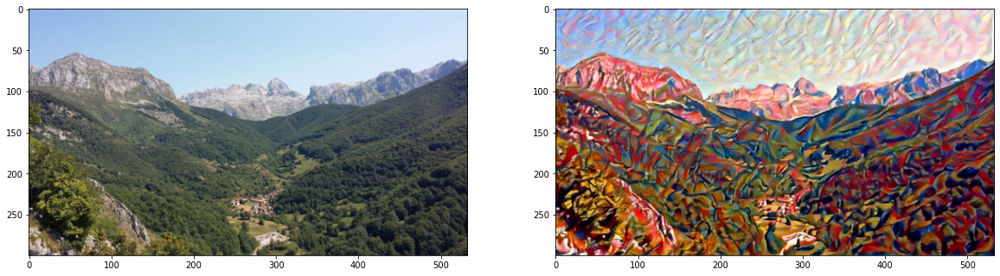

Pérdida total:  692.5765380859375
Pérdida contenido:  4.195990562438965
Pérdida estilo:  2.7297747135162354
Step 1500


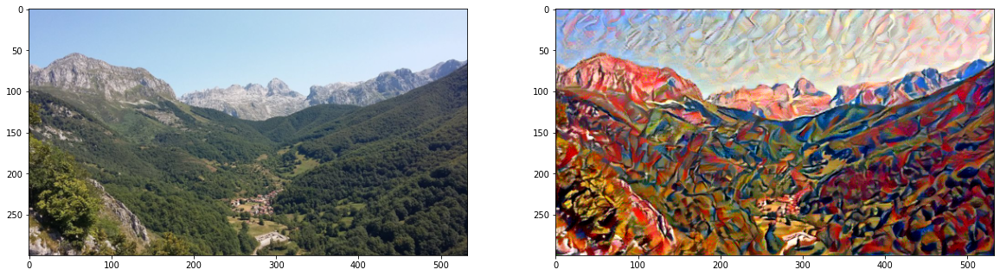

Pérdida total:  615.315185546875
Pérdida contenido:  3.938284158706665
Pérdida estilo:  2.2148678302764893
Step 2000


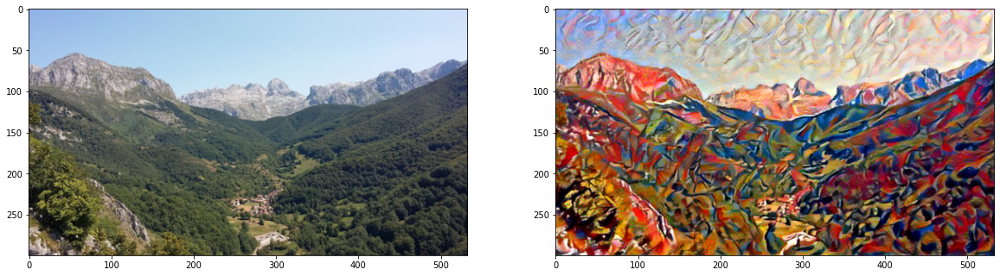

################################################################
Content weight: 100.0 - Style weight: 0.01
Pérdida total:  4.654076099395752
Pérdida contenido:  0.004829535726457834
Pérdida estilo:  417.11224365234375
Step 500


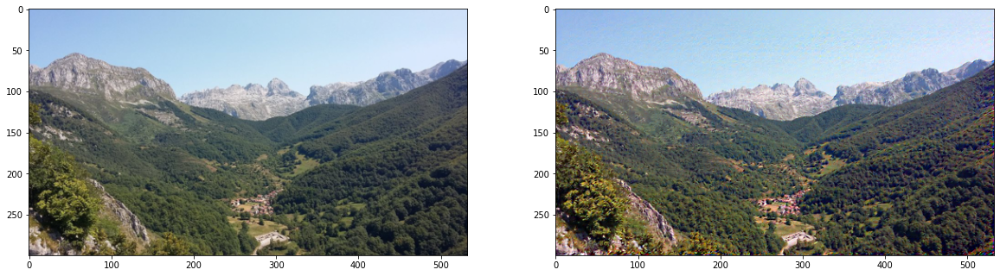

Pérdida total:  3.249615430831909
Pérdida contenido:  0.005091662984341383
Pérdida estilo:  274.044921875
Step 1000


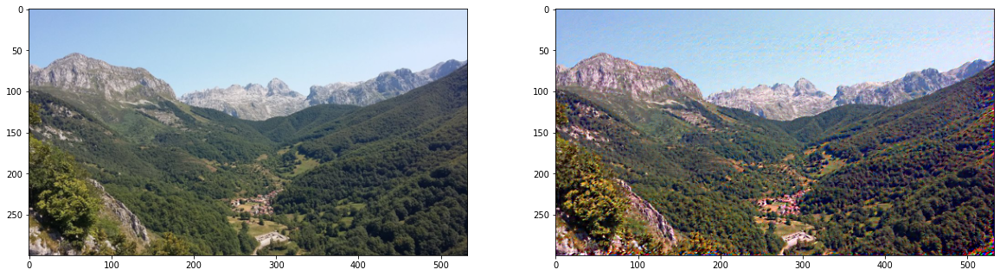

Pérdida total:  2.7495522499084473
Pérdida contenido:  0.0050146495923399925
Pérdida estilo:  224.80873107910156
Step 1500


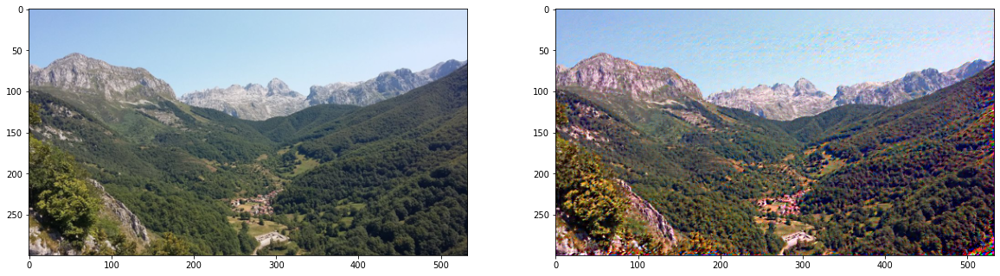

Pérdida total:  2.4844048023223877
Pérdida contenido:  0.004789125639945269
Pérdida estilo:  200.54922485351562
Step 2000


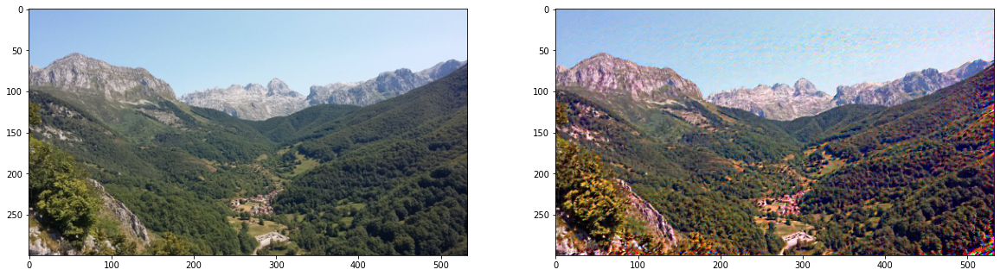

################################################################
################################################################
Learning Rate 0.1
Content weight: 1 - Style weight: 1000000.0
Pérdida total:  1040872.25
Pérdida contenido:  14.536388397216797
Pérdida estilo:  1.0408576726913452
Step 500


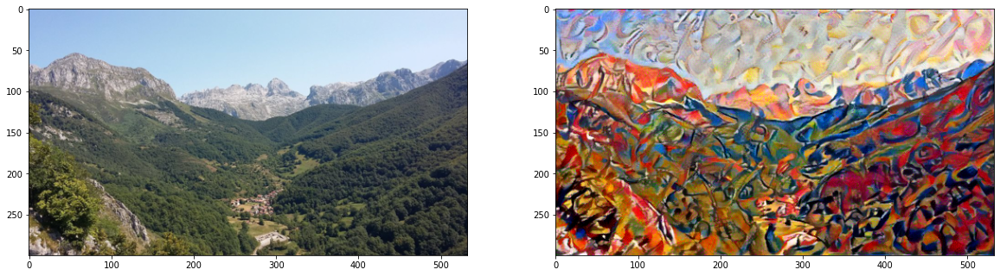

Pérdida total:  1137187.375
Pérdida contenido:  14.472603797912598
Pérdida estilo:  1.137172818183899
Step 1000


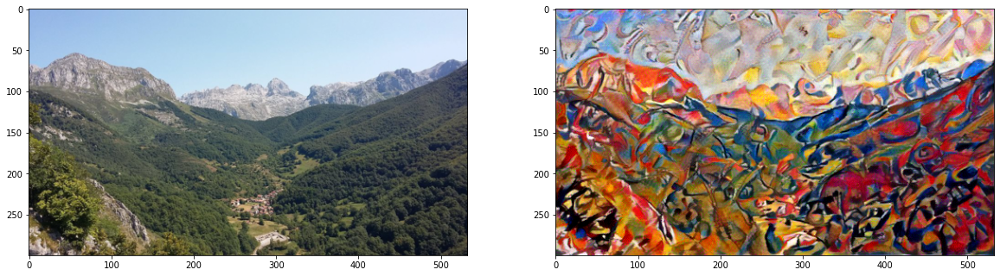

Pérdida total:  382704.1875
Pérdida contenido:  14.969610214233398
Pérdida estilo:  0.3826892077922821
Step 1500


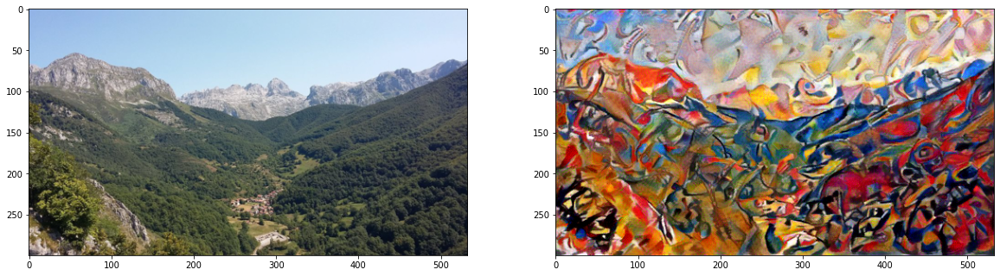

Pérdida total:  230148.421875
Pérdida contenido:  14.960543632507324
Pérdida estilo:  0.23013347387313843
Step 2000


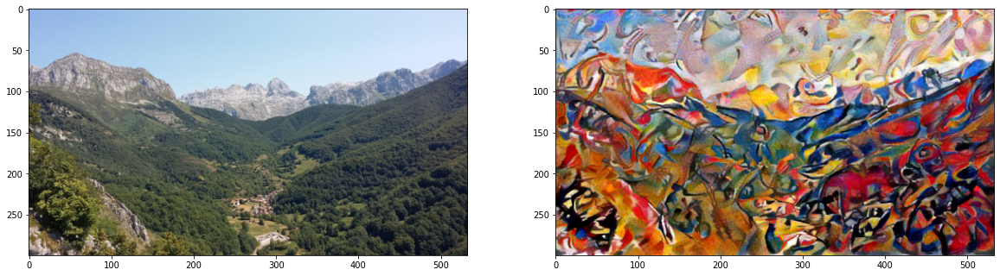

################################################################
Content weight: 100.0 - Style weight: 100.0
Pérdida total:  580.5961303710938
Pérdida contenido:  3.755553960800171
Pérdida estilo:  2.0504074096679688
Step 500


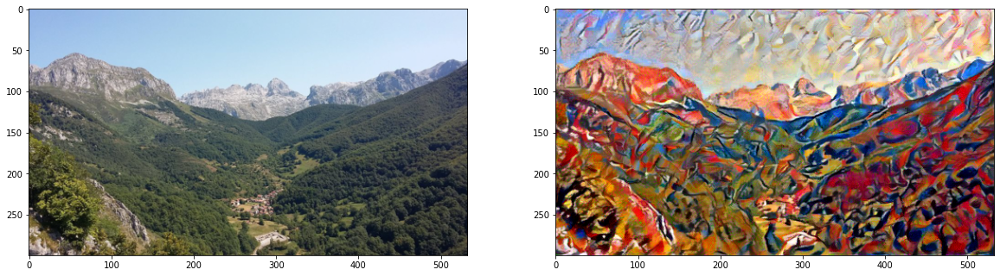

Pérdida total:  545.3256225585938
Pérdida contenido:  3.358447313308716
Pérdida estilo:  2.094809055328369
Step 1000


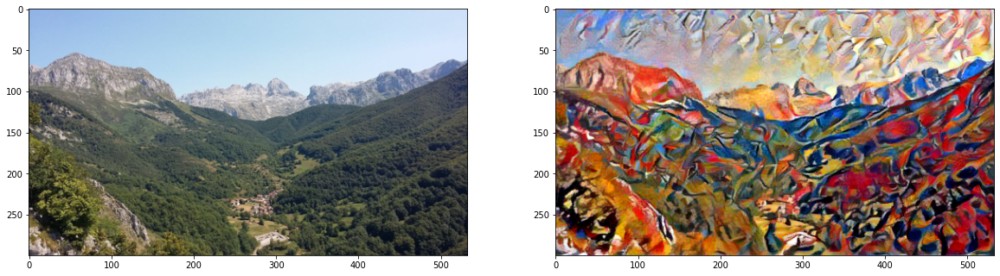

Pérdida total:  472.69305419921875
Pérdida contenido:  3.1637816429138184
Pérdida estilo:  1.5631486177444458
Step 1500


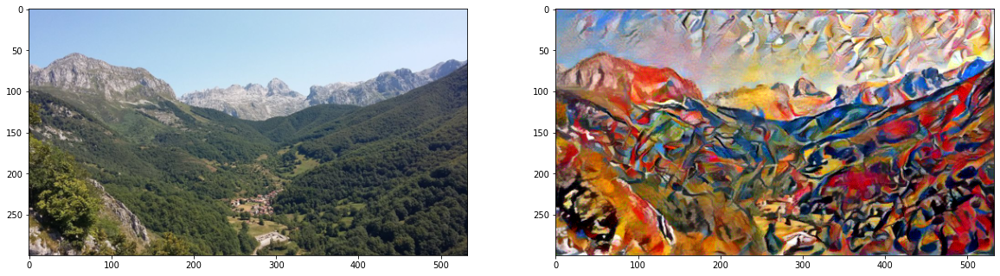

Pérdida total:  456.76544189453125
Pérdida contenido:  3.0304601192474365
Pérdida estilo:  1.5371941328048706
Step 2000


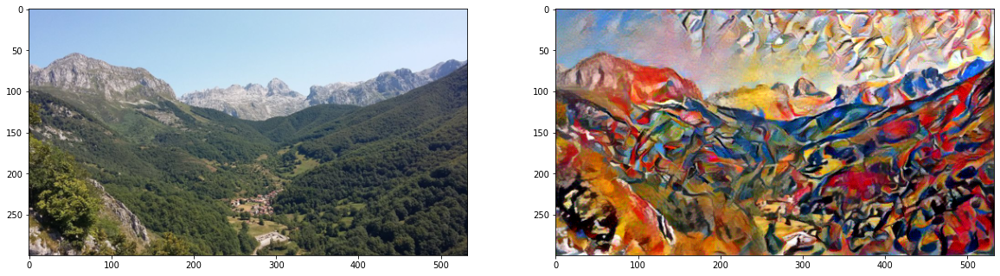

################################################################
Content weight: 100.0 - Style weight: 0.01
Pérdida total:  5.186911582946777
Pérdida contenido:  0.023783912882208824
Pérdida estilo:  280.8520202636719
Step 500


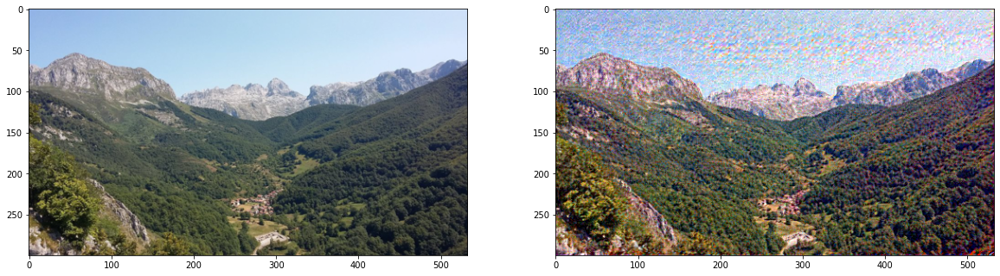

Pérdida total:  4.852243423461914
Pérdida contenido:  0.02442339062690735
Pérdida estilo:  240.99046325683594
Step 1000


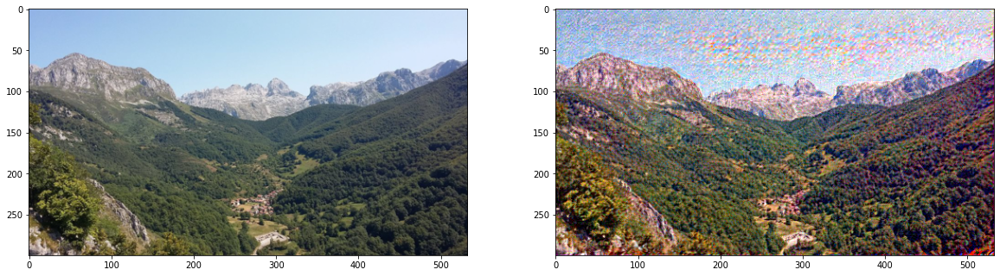

Pérdida total:  3.943681240081787
Pérdida contenido:  0.0176992267370224
Pérdida estilo:  217.3758544921875
Step 1500


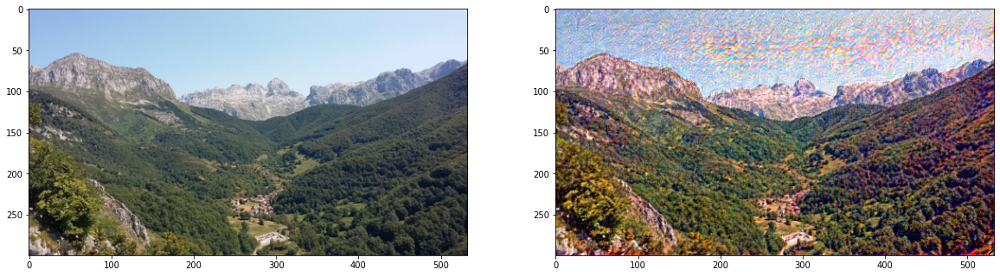

Pérdida total:  5.499896049499512
Pérdida contenido:  0.02756008878350258
Pérdida estilo:  274.38873291015625
Step 2000


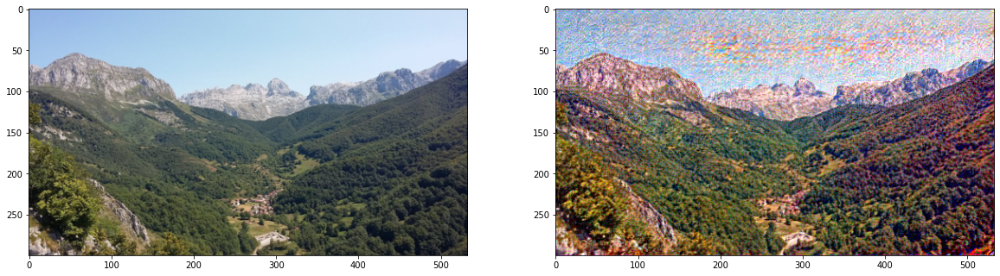

################################################################
################################################################


In [ ]:
steps = 2000 # número de iteraciones
# definimos cada cuántas imágenes queremos hacer una visualización intermedia
show_every = 500

for learning_rate in [0.003, 0.01, 0.1]:
    print("Learning Rate", learning_rate)
    for content_weight, style_weight in [[1, 1e6], [1e2, 1e2], [1e2, 1e-2]]:
        print( f'Content weight: {content_weight} - Style weight: {style_weight}')
        train(content, style, vgg_features, device, learning_rate, steps, style_weights, style_weight, content_weight, show_every) # se define una función para el entrenamiento.
        print("################################################################")
    print("################################################################")


Según qué parámetro vaya cambiando podemos apreciar los siguiente:

* **Aumento del número de steps**: A medida que aumenta el número de steps o iteraciones vemos cómo la imagen final cada vez tiene más características propias de la imagen de estilo. Esta tendencia se observa sobre todas las series de imágenes que nos devuelve el método *train*, donde el resto de parámetros como el *learning rate* y los pesos se mantienen constantes.

* **Cambios en el learning rate**: Conforme aumentamos el *learning rate* vemos un avance más rápido, siendo necesarias muy pocas iteraciones, pasando de una imagen muy similar a la imagen de contenido hacia una imagen con un estilo propio de la imagen de estilo. Esto se ve en todos los casos, sin importar la distribución de pesos usados.

  Con un learning rate muy bajo necesitaríamos muchas iteraciones para incluir cambios en el cuadro. Esto requiere muchos recursos y además podríamos vernos atrapados en un mínimo local, llegando a un punto de estancamiento donde las características de estilo dejan de añadirse.

  Por contra, con un learning rate muy alto se requieren muy pocas iteraciones para modificar la imagen de contenido. Sin embargo, existe el riesgo de que la red deje de converger y no sea capaz de añadir correctamente las características a la imagen de contenido y sin distorsionarla.



* **Diferentes pesos de estilo y contenido**: Partimos de que la función de pérdida total se calcula como la suma ponderada de dos funciones de coste:

  $$L_{total\ loss} = \omega_{content}  L_{content\ loss} + \omega_{style}  L_{style\ loss}$$

  Donde $L_{total\ loss}$ es la función de coste total, sobre la cual vamos a buscar un mínimo. $L_{content\ loss}$  es la función de coste contenido, que mide la diferencia entre la capa convolucional 21 y las características de la imagen contenido. $L_{style\ loss}$ representa la función de coste estilo y mide las diferencias entre las características extraídas del cuadro y las capas de estilo 0, 5, 10, 19 y 28 (aquellas que están justo después de un max pooling). Para ello se ponderan a su vez estas diferencias con el vector *style_weights*. Por último, $\omega_{content}$ y $\omega_{style}$ son números positivos que tienen en cuenta la importancia relativa de las funciones de coste.

  Los resultados muestran diferencias al variar los pesos relativos de las funciones de coste entre la imagen contenido y de estilo. Cuanto mayor es el peso atribuido a la función de coste de estilo, mayores son las características estilísticas transferidas del cuadro a la imagen final. Esto se cumple en todas las series de imágenes en los que el *learning rate* se ha mantenido constante. 
  
  
Teniendo en cuenta lo explicado podemos ver el efecto conjunto que tiene modificar estos tres parámetros. Distinguimos dos casos extremos: 

* En los ejemplos con un learning rate muy bajo (0.003) y con pesos de estilo muy bajos (0.01) relativos al peso en contenido (100), no se ven prácticamente cambios sobre la imagen de contenido original conforme la transferencia de estilo va avanzando. Las imágenes resultantes se ven un poco menos nítidas que la imagen contenido original, las formas pierden definición y los colores se enrojecen.

* El efecto contrario lo vemos con el learning rate más alto (0.1), peso de estilo $10^6$ y peso de contenido 1. En la iteración 500 ya se aprecia una alta transferencia de estilo del cuadro a la imagen de contenido. La imagen va absorbiendo cada vez más características del cuadro conforme las iteraciones suben. De esta forma, la imagen resultante con 2000 iteraciones presenta una saturación de colores tan alta que ya no parece una fotografía en sí, sino un cuadro.


# Conclusiones

En esta actividad hemos empleado el primer bloque del modelo VGG19, que sirve para extraer las características de la imagen de entrada. Hemos visto que consta de varias capas convolucionales y capas de max pooling. Así, se han extraído las características de aquellas capas convolucionales sucesoras de una capa max pooling así como de la primera capa convolucional para calcular la función coste de estilo. Por otro lado, se han inicializado las características de la imagen contenido en una capa próxima al final de la red como es la capa 21. La función de coste contenido se ha tomado como la diferencia entre esta capa y las características de la imagen contenido.

Con respecto al primer bloque, hemos visto el significado de los parámetros de entrada de las funciones conv. También hemos analizado la parte clasificadora de VGG19. Hemos explicado las funciones que se usan en el clasificador y el significado de sus parámetros. Además, hemos respondido a preguntas generales sobre este bloque, como cuántas etiquetas diferentes es capaz de clasificar.

Por último, hemos hecho diferentes transferencias de estilo cambiando los hiperparámetros learning rate y los pesos de estilo y contenido. Se han analizado el impacto de cada cambio de forma general, concluyendo que un learning rate alto, un peso de estilo alto y un peso de contenido bajo conlleva una transferencia acelerada (en muy pocas iteraciones) de la imagen de estilo, y viceversa.









